## Seung Jun Choi in Urban Information Lab

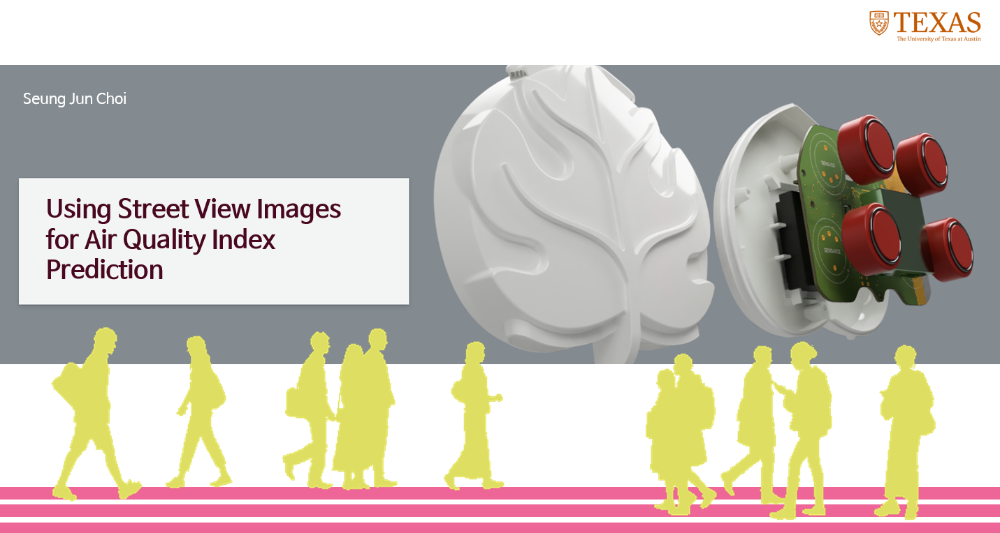

In 2020, Microsoft’s Urban Innovation team partnered with JCDecaux and Array of Things to deploy over 100 low-cost air pollution sensors across Chicago. The custom-designed sensors can measure CO₂, NO₂, SO₂, O₃, PM₁, PM₂.₅, and PM₁₀, as well as temperature, humidity, and pressure.

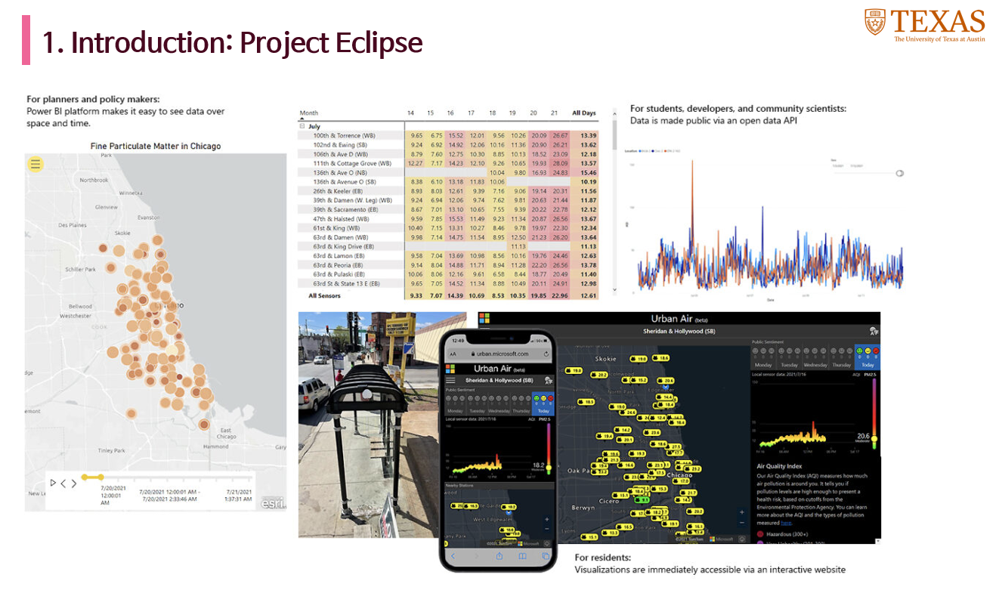

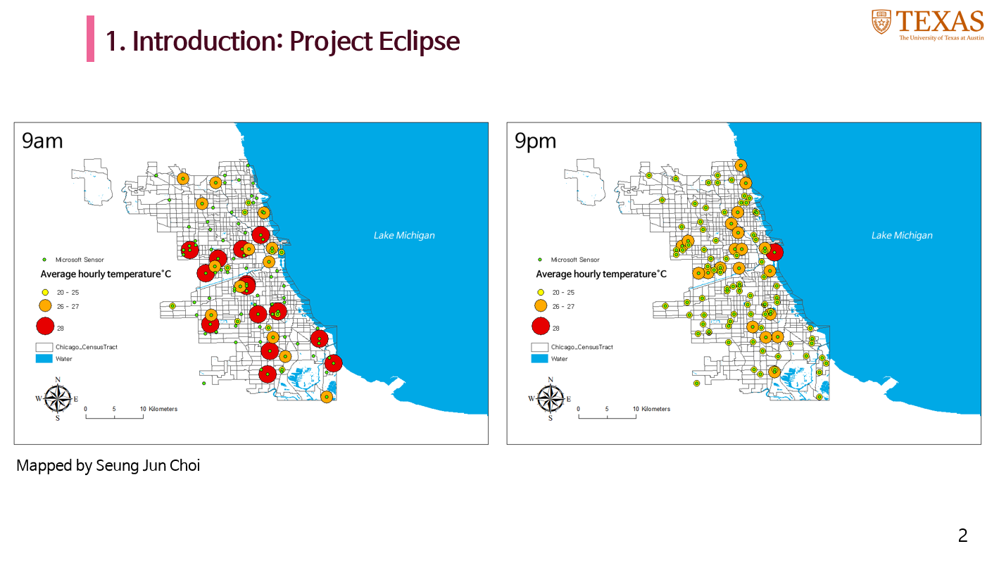

The sensor network is referred to as Project Eclipse. As of August 2021, 110 Project Eclipse sensors had been installed throughout the city of Chicago. The figure below illustrates the deployment of these sensors and presents the daily average air quality during the study period.

## AQI

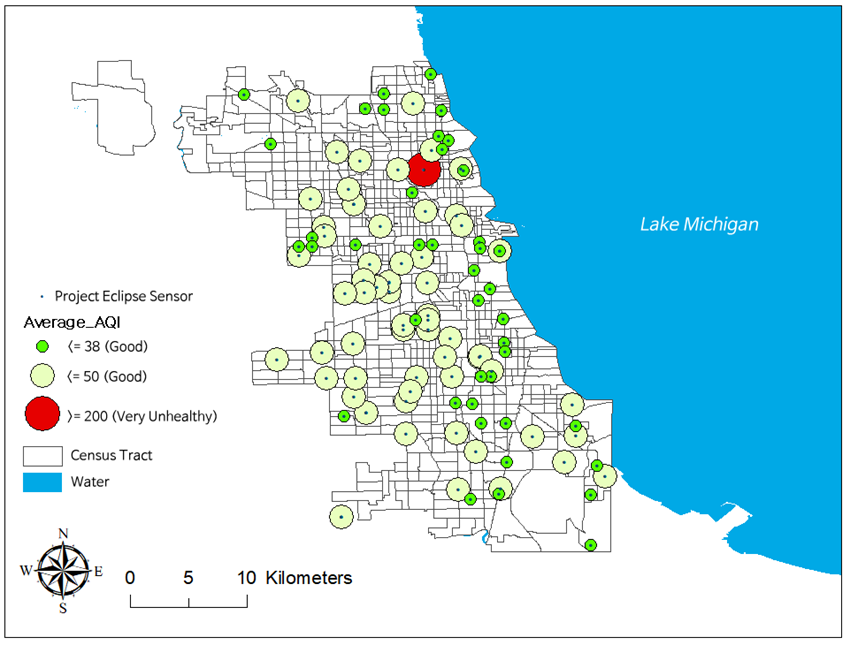

The plan follows EPA air quality standards, where higher index values indicate greater health risks. The AQI is categorized as follows: 0–50 (Good), 51–100 (Moderate), 101–150 (Unhealthy for Sensitive Groups), 151–200 (Unhealthy), 201–300 (Very Unhealthy), and 301 and above (Hazardous).

The image below illustrates the hourly AQI monitored by all sensors during the study period. For the most part, air quality in Chicago remained in good or moderate conditions. However, instances of “unhealthy for sensitive groups,” “unhealthy,” “very unhealthy,” and “hazardous” conditions were more frequent in Chicago compared to other cities. Overall, Chicago generally maintains good or moderate air quality, but occasional spikes to unhealthy or even hazardous levels signal emergency health warnings.

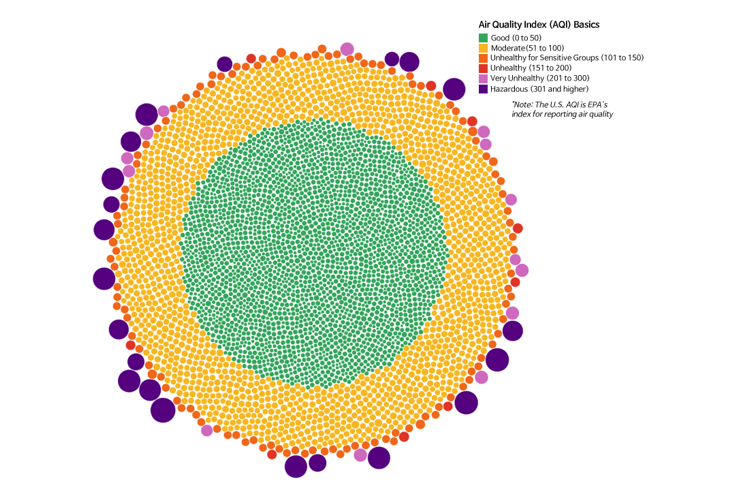

Typically, land use maps and Landsat satellite images are used to analyze urban landscapes. This study, however, compared Google Street View images with these conventional methods. Google Street View images were assessed to capture the surrounding urban environment for each deployed Project Eclipse sensor. To facilitate this, the study utilized the Google Street View Static API to automatically download images using address information.

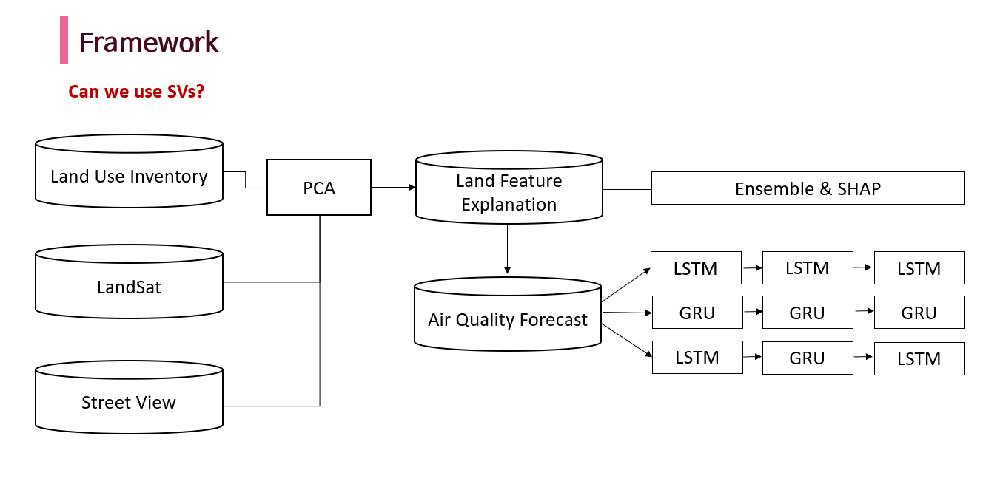

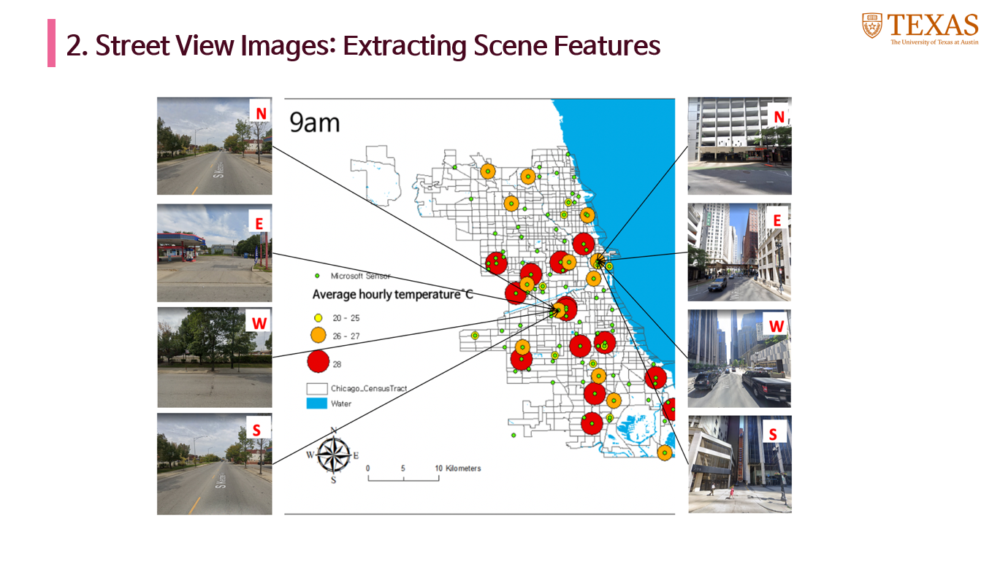

The necessary parameters for extracting Google Street View images include the location (latitude and longitude) or pano ID (specific panorama identifier), the output image size, the API key, and other optional parameters such as heading (camera’s viewing angle), FOV (horizontal field of view), and pitch (up-and-down angle of the camera relative to the street view vehicle). For each street node, four Google Street View images were generated at heading angles of 0°, 90°, 180°, and 270° using the Google Street View Static API. Images are only available at these four heading angles. We retrieved street view images no earlier than 2019 and ensured they corresponded to Project Eclipse sensor locations in Chicago.

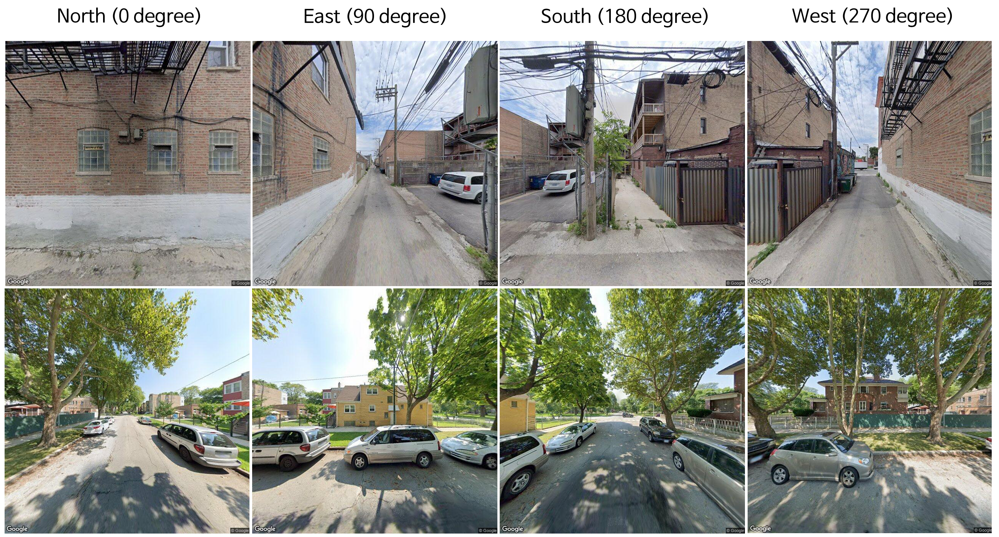

The development of convolutional neural networks (CNNs), such as VGG (Simonyan & Zisserman, 2015), ResNet (He et al., 2015), YOLO (Redmon & Farhadi, n.d.), and Mask R-CNN, has provided efficient approaches for automatically extracting scene features from street view images. Neural networks like YOLO and ResNet are widely used for object detection (R. Huang et al., 2018; Hendry & Chen, 2019; Hewitt et al., 2020) as well as image classification (Kang et al., 2018; Liu et al., 2018; Cui et al., 2020).

## ResNet50
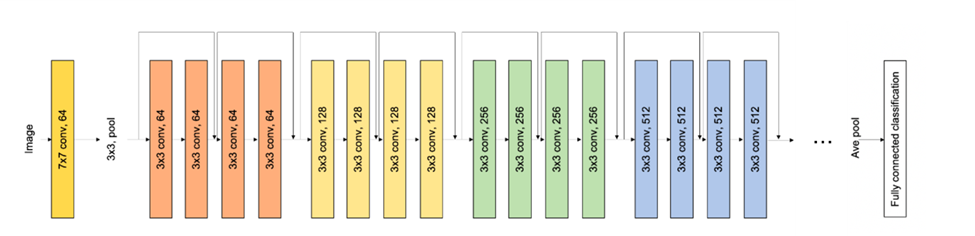

ResNet50 is pretrained on the Places365 dataset, which classifies images into 365 scene categories, such as highway, forest, field, street, church, plaza, and others. ResNet50 employs an identity shortcut connection mechanism, allowing the model to skip one or more layers during training.

When using the VGG network, additional convolutional layers can be added to improve performance, whereas ResNet dynamically determines the number of layers needed to achieve higher accuracy. ResNet50, in particular, requires relatively fewer parameters and lower computational cost for feature extraction compared to other methods. The weights of the ResNet50 model were trained on 18 million images, enabling it to classify images with high accuracy.

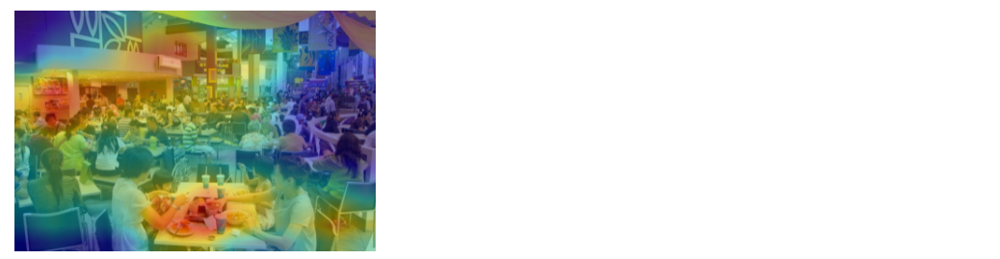

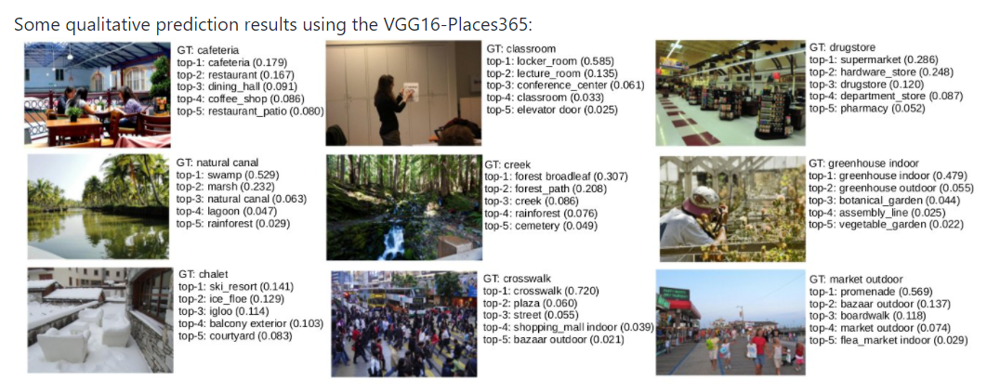

https://github.com/CSAILVision/places365

# Conventional landscape assessment

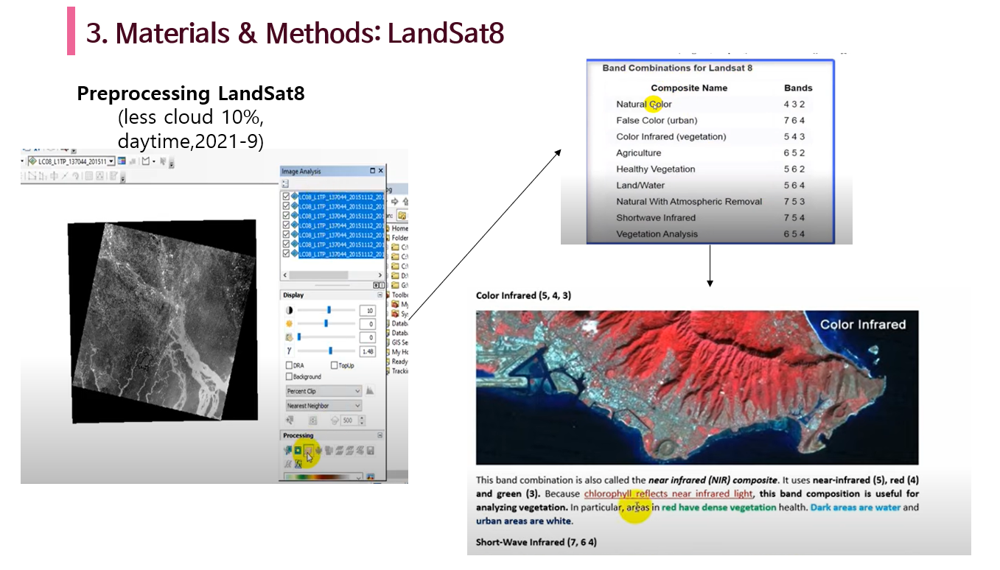

For satellite image extraction, we used Landsat 8 imagery from September 2021, which was the most recent available during the study period. The selected image had minimal cloud cover (less than 10%) and was captured during daytime. ArcMap provides a supervised classification tool, which allows training samples to be used via the image classification toolbar. The tool then measures the classes and their statistics based on the training samples (ArcMap, n.d.). Using a band combination, also known as the NIR (Near Infrared) composite in Landsat 8, we classified land use types into waterbody, vegetation, dense settlement, and barren land, as illustrated in the figure below.

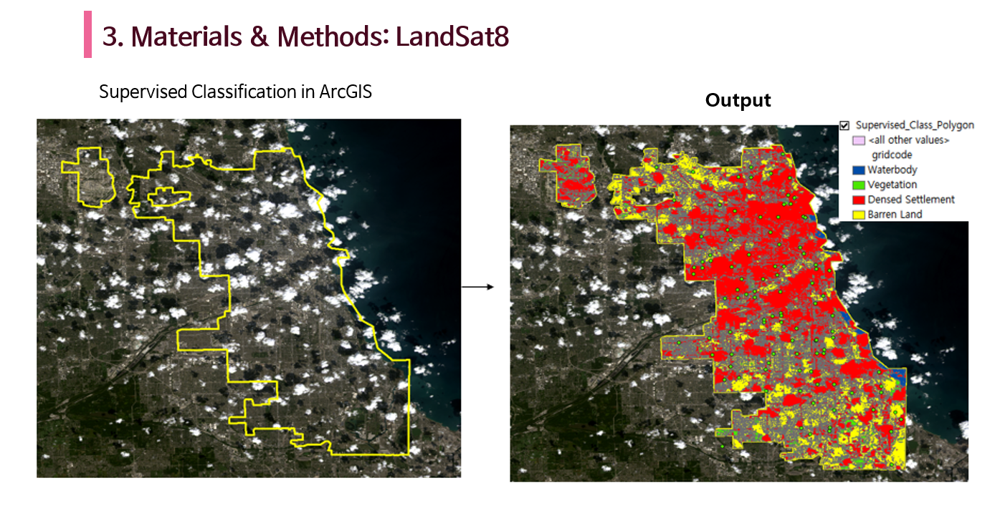

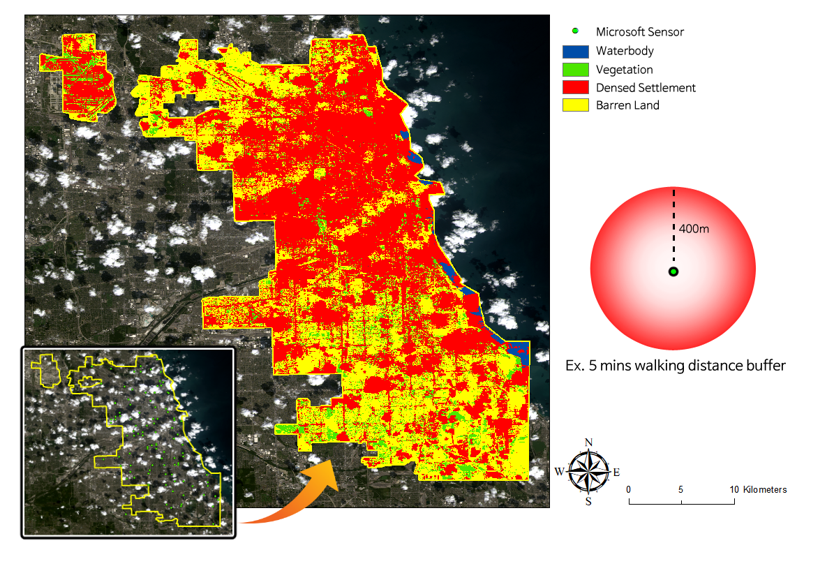

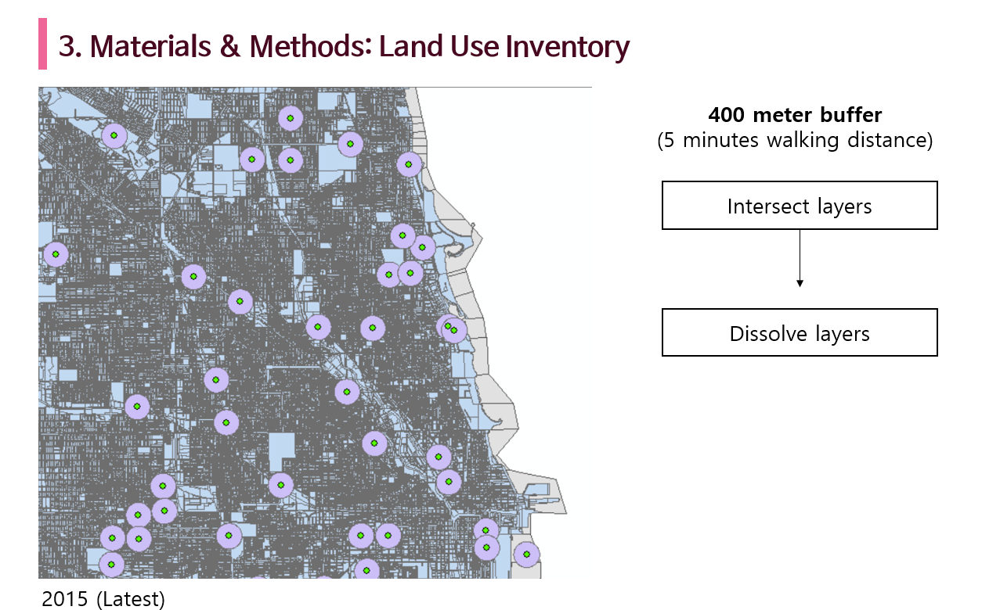

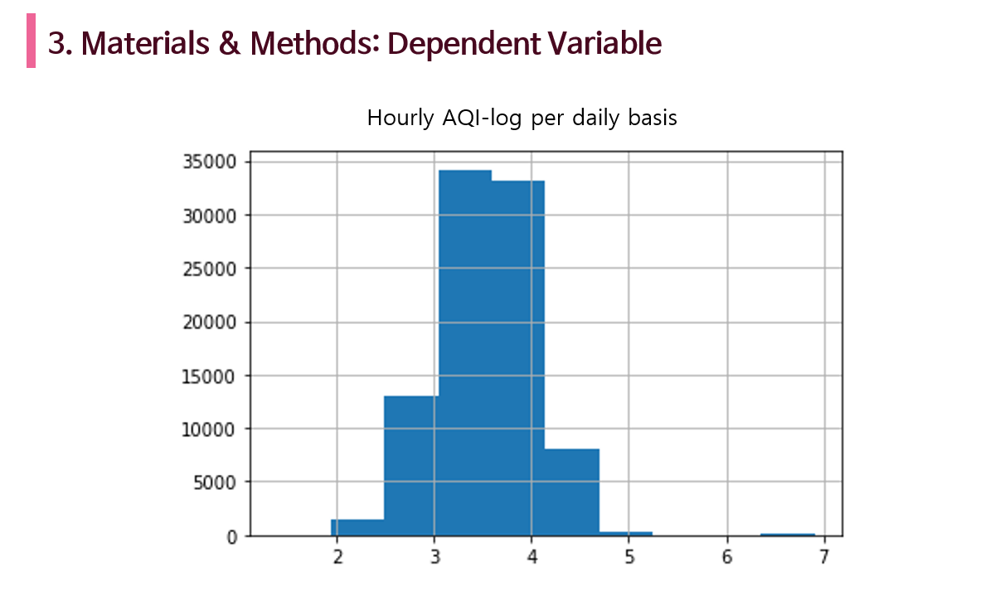

Out of the 110 Project Eclipse sensors, a total of 104 were used in the analysis. The dependent variable was transformed using the natural logarithm.

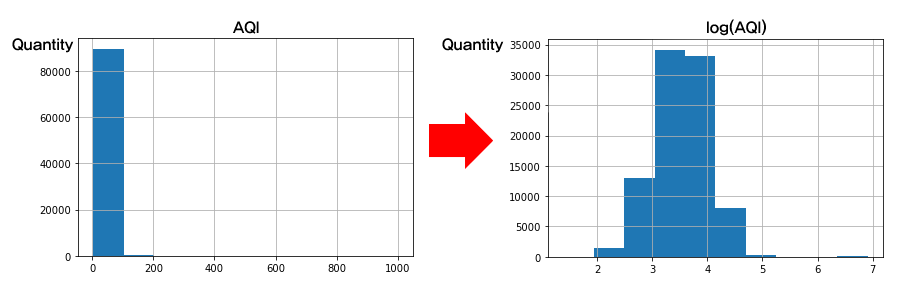

This study names the calculated PCA scores as land use feature score. A positive and negative value of each score only implicates the direction of vectors, so comparing the variance score is not favored.

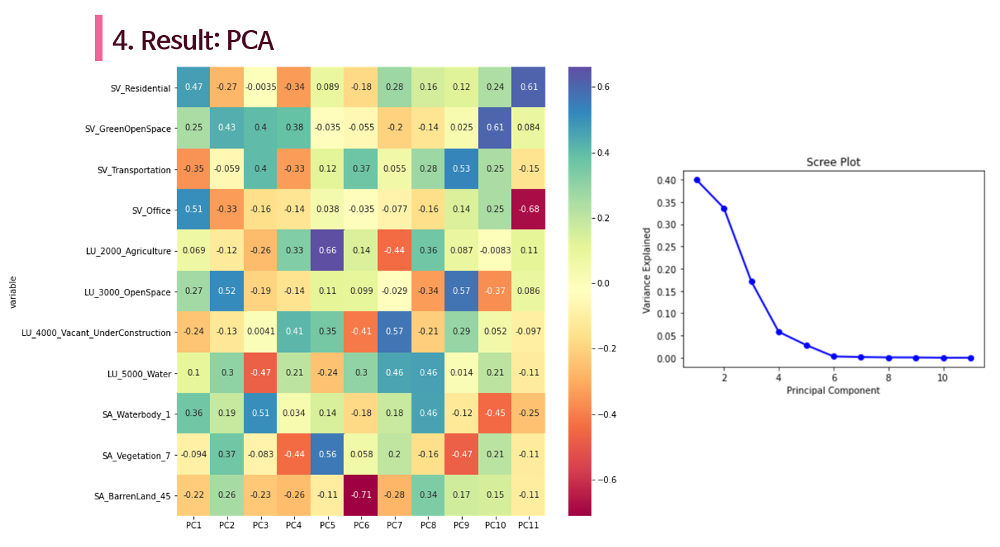

The results reveal that the deployed Project Eclipse sensors in Chicago share similar characteristics; however, some sensors exhibit unique features. For example, the orange-colored dot on the left side of the biplot appears to correspond to a relatively higher proportion of barren land compared to the other sensors.

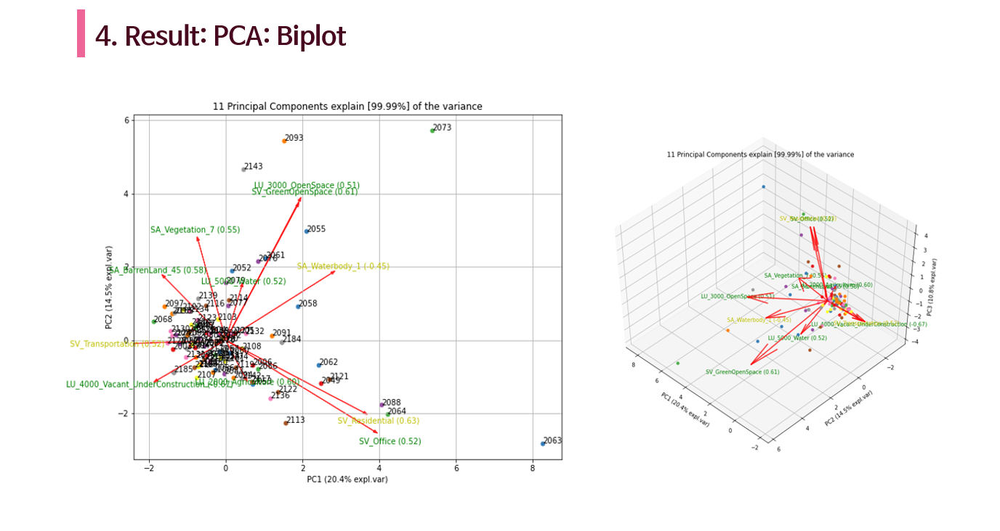

The question arises as to how Project Eclipse sensors No. 2073 and 2093 capture land use in areas with high levels of green open space or proximity to the lakeshore. As shown in the satellite images in the maps below, these sensors are located either within large areas of green open space or adjacent to Lake Michigan.

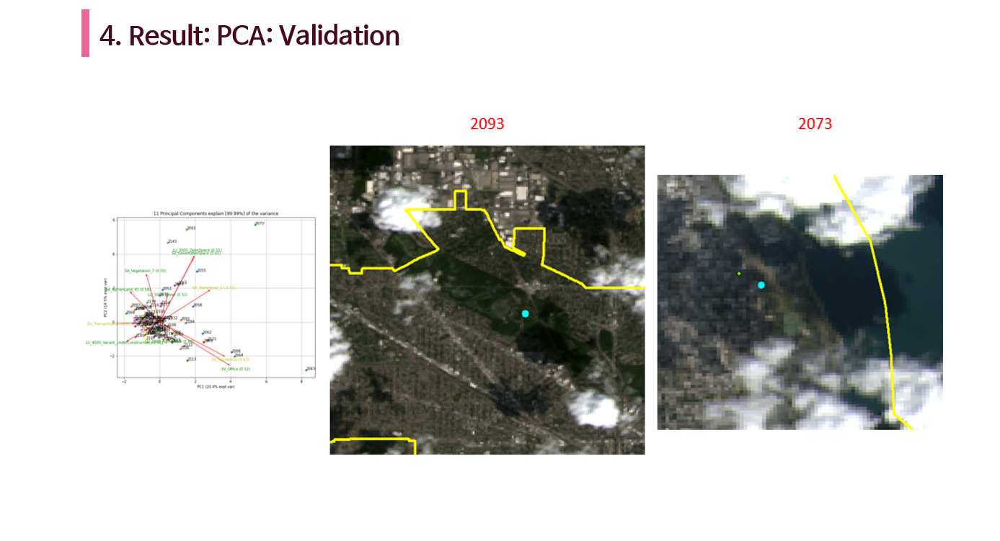

This study employed ensemble machine learning models to evaluate feature explanatory power. Ensemble models are capable of illustrating feature importance, which provides insights into the effects of land use on hyperlocal, sensor-based air quality in Chicago.

While ordinary machine learning trains a single hypothesis, ensemble learning combines multiple learners to solve a joint problem. Among the four ensemble models tested, Random Forest (RF) was selected due to its lowest error scores. The optimization of hyperparameters was also carried out to further improve model performance.

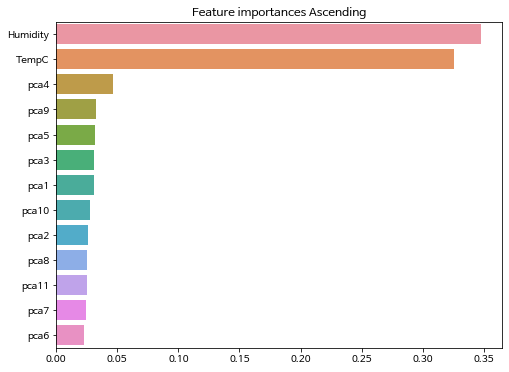

Nevertheless, feature importance on its own provides only a ranking of variables. In other words, the effect of variables on air quality cannot be fully understood without employing additional feature explanation methods.

Additive exPlanations (SHAP) values are used to evaluate feature explanations. They represent a way to capture either positive or negative relationships between feature contributions and the dependent variable.

Rozemberczki et al. (2022) provided a clear example of SHAP value calculation in ensembles, illustrated in Figure 8. In this example, the robots in red, blue, and green each represent a player, which corresponds to models in the ensemble. The coins represent the prediction gains, which serve as the payoff for each possible coalition (robots grouped in rectangles). In this context, the Shapley value distributes the total gain of the grand coalition (shown in the bottom-right corner of Figure 8) among the individual players.

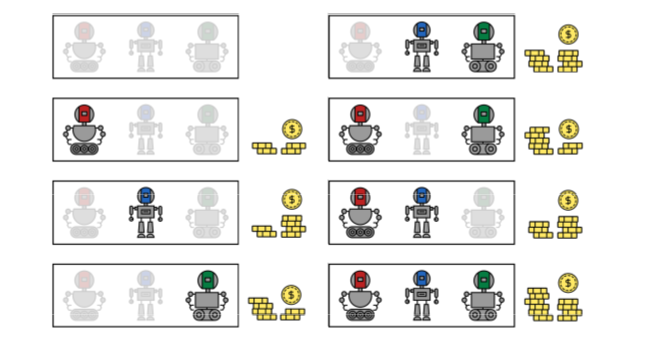
(Rozemberczki et al., 2022)

Shapley values refer to the mean marginal contribution of features, calculated by repeatedly considering all possible coalitions. This approach provides a fair way to distribute the “payout” (Molnar, n.d.). Similar to feature importance plots, SHAP plots are typically presented in descending order. Figure 12 illustrates both local and global SHAP summary plots.

In the local SHAP plot, red and blue dots represent high and low feature values, respectively. Along the X-axis, the left side indicates a negative (–) correlation with the dependent variable, while the right side indicates a positive (+) correlation. Although the dots are fairly evenly distributed overall, there are more red dots with higher values on the positive side of the axis. This suggests that PCA9 is predominantly positively related to the dependent variable, air quality.

To simplify interpretation, Dataman (2021) proposes a global SHAP plot as a condensed version of the local SHAP plot. In the global SHAP plot, red indicates a positive correlation, while blue indicates a negative correlation with the dependent variable.

The results show that average humidity, average temperature, PCA4, PCA9, PCA8, PCA10, and PCA6 have positive (+) correlations with the dependent variable. Meanwhile, PCA3, PCA2, PCA5, PCA1, PCA7, and PCA11 have significant negative (–) correlations. However, since higher values of the dependent variable indicate poorer air quality, the interpretation should be inverted. Thus, PCA3, PCA2, PCA5, PCA1, PCA7, and PCA11 are the features that contribute to maintaining cleaner air quality.

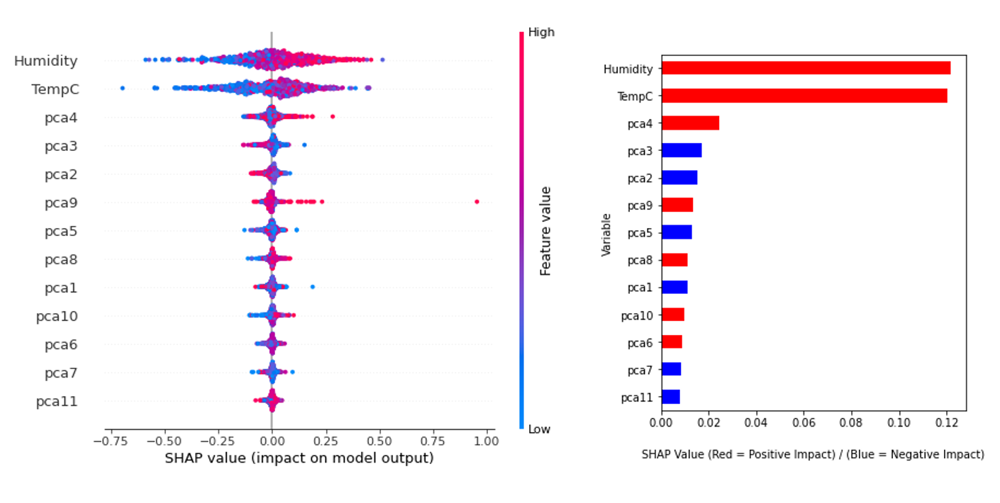

However, it is important to note that land use features exhibit more complex relationships with the predicted outcome compared to meteorological factors. Dependence plots illustrate the marginal effect of one or two features on the predicted outcome (Friedman, 2001). As shown in the dependence plot in Figure 13, average temperature and average humidity display an approximately positive and linear trend and frequently interact with one another. By contrast, land use feature scores—although they may interact with each other (e.g., PCA2 & PCA6; PCA3 & PCA4)—exhibit complex, non-linear relationships with the dependent variable. Therefore, it would be premature to conclude that either positively (+) or negatively (–) correlated land use feature scores have decisive effects on air quality. Instead, the results suggest that the influence of urban landscape on air quality is characterized by more complex interactions than those observed for meteorological factors.

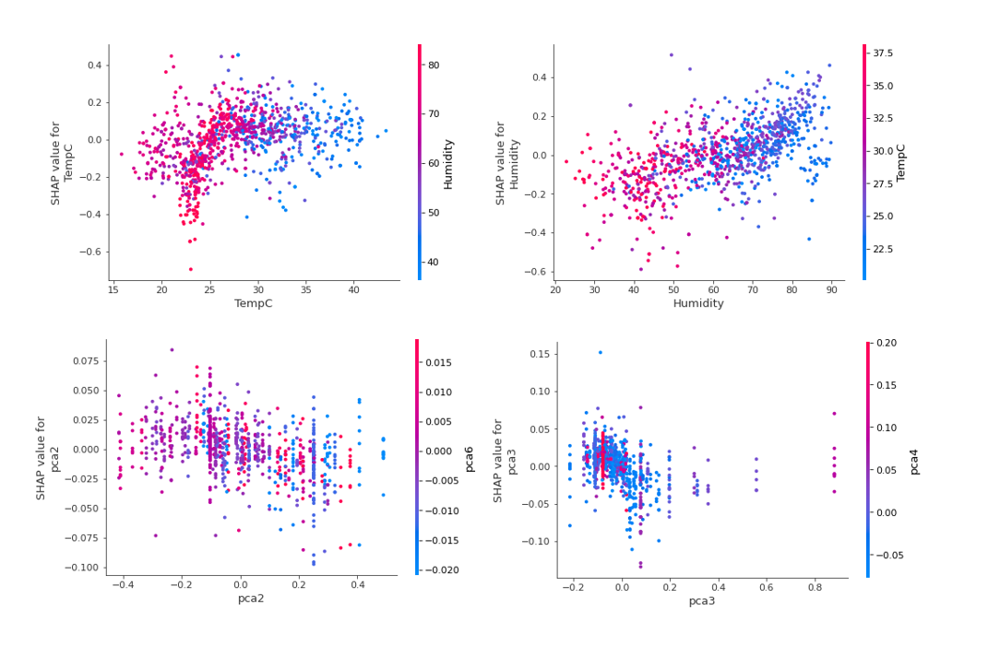

For the air quality forecast, three neural network models were developed: LSTM, GRU, and a HYBRID model (a combination of LSTM and GRU). All three models underwent an optimization process and were trained using the same hyperparameter settings. During training, the training loss and testing loss were compared to identify and address potential overfitting or underfitting issues. The results showed that these issues could be mitigated under specific hyperparameter configurations.

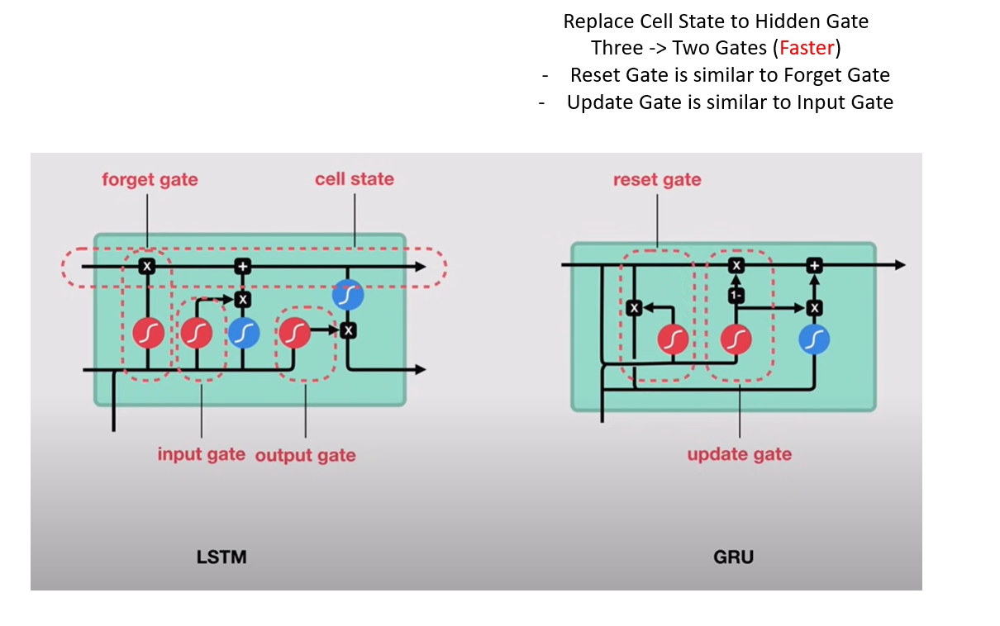

The results indicate that the GRU model achieved a lower RMSE compared to both LSTM and HYBRID. GRU also obtained the highest R² score at 78%, meaning that 78% of the variance in the data was explained by the model in relation to air quality forecasting. LSTM and HYBRID followed in performance, in that order. However, when examining the loss curves, GRU exhibited a relatively less stable (or “fuzzier”) pattern compared to LSTM and HYBRID.

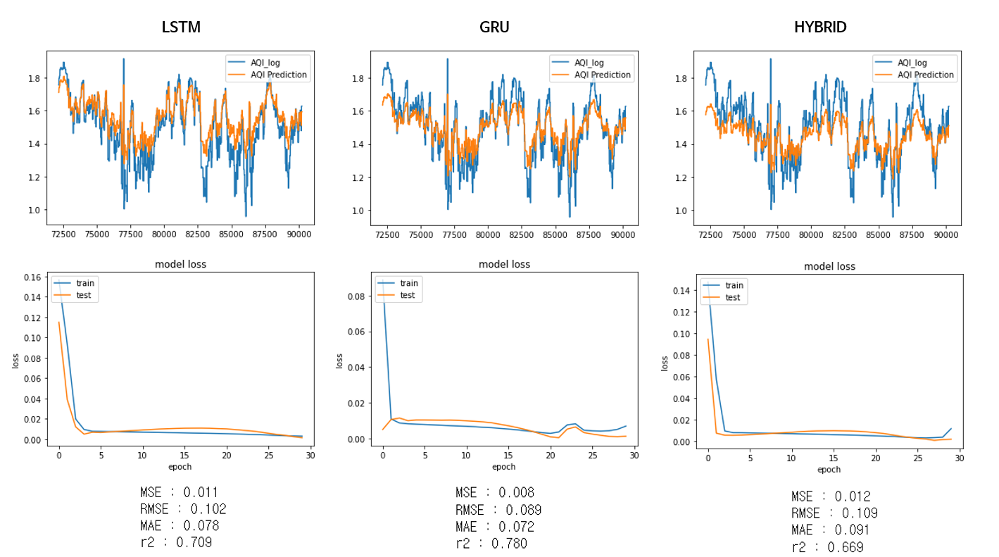

The decomposition of landscape features includes land use maps, satellite imagery, and street view images collected from the locations of Project Eclipse sensors in Chicago. Although this decomposition process is critical for air quality forecasting (Iskandaryan et al., 2020; Amato et al., 2020), a major limitation is that it provides limited feasibility for interpreting the explanatory power of individual features with respect to the dependent variable. PCA helps reduce data dimensionality and improve interpretability; however, it also results in information loss (Jolliffe & Cadima, 2016).

This study has several limitations. First, the ResNet50 model used was pretrained on Places365, which may make it vulnerable to handling biases. Second, as noted above, PCA analysis is prone to information loss. Third, the reliability of Microsoft’s Project Eclipse AQI measurement mechanism may be questionable.

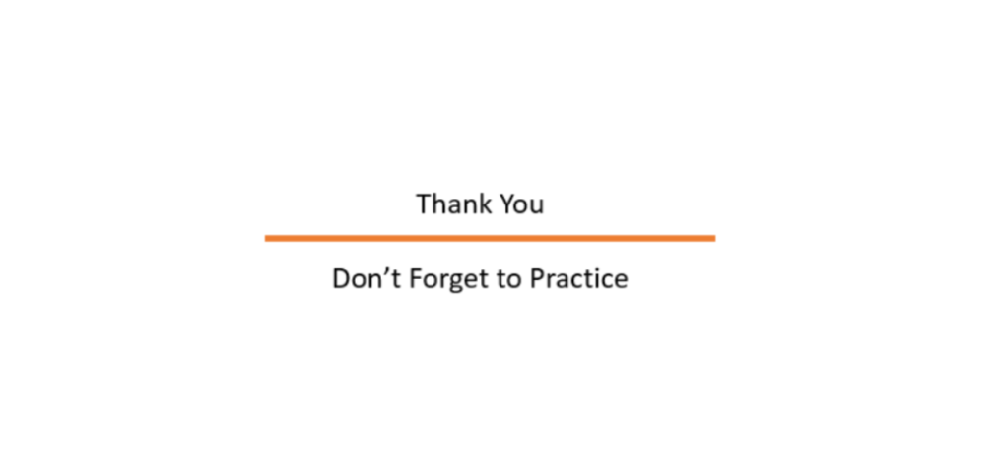